# Title of the Analysis

**Authors:** 

## Overview



## Business Problem

Explain the business problem and include relevant sources to fully describe what the problem is, how it can be solved using models, and what is trying to be determined by the models. include background on the issue and related studies.

## Data Understanding

Describe where the data came from and how it relates to the business problem above. Give links to the data, a table with the relevant features and descriptions and links to other studies that give more information on the data set itself.

### Importing Packages and Loading the Datasets

In [1]:
#Import standard packages for data engineering and visualization
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
from datetime import date, datetime

#import packages to support geo visuals
import folium
from folium.plugins import HeatMap
import json

#Import packages to perform linear regression modeling and preprocessing tools
import statsmodels.api as sm
import scipy.stats as stats
from statsmodels.formula.api import ols

from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OrdinalEncoder, OneHotEncoder, PolynomialFeatures, StandardScaler
from sklearn.feature_selection import RFE
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.metrics import precision_score, recall_score, accuracy_score, f1_score, confusion_matrix, plot_roc_curve, classification_report, plot_confusion_matrix
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, RandomizedSearchCV
from imblearn.pipeline import Pipeline as ImbPipe
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import FunctionTransformer

from sklearn.ensemble import BaggingClassifier, RandomForestClassifier,\
ExtraTreesClassifier, VotingClassifier
#Import local functions from src/
import sys
sys.path.insert(0, '../../src/')
from eda import EdaPlots
import show_confusion
#Ignore warnings in cells
import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', None)

SyntaxError: invalid syntax (show_confusion.py, line 7)

In [4]:
# Import all related data sets

X = pd.read_csv('../../data/water_well_training_values.csv')
y = pd.read_csv('../../data/water_well_training_labels.csv')
df = pd.merge(y,X)

In [5]:
plots = EdaPlots()
plots.init(df)
plots.clean()

In [7]:
plots.df_['status_group'].value_counts()

functional                 31389
non functional             22268
functional needs repair     3931
Name: status_group, dtype: int64

In [22]:
plots.df_['status_group'].value_counts() / sum(plots.df_['status_group'].value_counts())

functional                 0.545061
non functional             0.386678
functional needs repair    0.068261
Name: status_group, dtype: float64

### Get an understanding of the data

Thurough description of the key features, data types, possible problems that need to be solved with cleaning and some suggestions of feature engineering.

## Data Preparation

In [85]:
#check for duplicates in the data
df[df.duplicated()]

,id,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,scheme_name,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group


We found no duplicate rows.

### Dealing with missing values 

In [86]:
# drop id column
df.drop('id',axis=1,inplace=True)

In [87]:
# Confirm the columns with missing values
df.isna().sum()

status_group                 0
amount_tsh                   0
date_recorded                0
funder                    3635
gps_height                   0
installer                 3655
longitude                    0
latitude                     0
wpt_name                     0
num_private                  0
basin                        0
subvillage                 371
region                       0
region_code                  0
district_code                0
lga                          0
ward                         0
population                   0
public_meeting            3334
recorded_by                  0
scheme_management         3877
scheme_name              28166
permit                    3056
construction_year            0
extraction_type              0
extraction_type_group        0
extraction_type_class        0
management                   0
management_group             0
payment                      0
payment_type                 0
water_quality                0
quality_

In [88]:
# Fill NaN values according to appropriate method
df['funder'].value_counts()

Government Of Tanzania         9084
Danida                         3114
Hesawa                         2202
Rwssp                          1374
World Bank                     1349
                               ... 
Tanz/egypt Technical  Co-op       1
Mwakifuna                         1
St Magreth Church                 1
Taipo                             1
Tasaf 1                           1
Name: funder, Length: 1897, dtype: int64

In [89]:
df['funder'].fillna(value='missing',inplace =True)

In [90]:
df['funder'].isna().sum()

0

In [91]:
df['installer'].value_counts()

DWE           17402
Government     1825
RWE            1206
Commu          1060
DANIDA         1050
              ...  
VIFAI             1
Water AID         1
plan Int          1
Huches            1
Mr Kwi            1
Name: installer, Length: 2145, dtype: int64

In [92]:
df['installer'].fillna(value='missing',inplace=True)

In [93]:
df['subvillage'].value_counts()

Madukani      508
Shuleni       506
Majengo       502
Kati          373
Mtakuja       262
             ... 
Ikanulime       1
Nyambeni A      1
Omukisimbi      1
Mchocholo       1
Izumu           1
Name: subvillage, Length: 19287, dtype: int64

In [94]:
df['subvillage'].fillna(value='none',inplace=True)

In [95]:
df['public_meeting'].value_counts()

True     51011
False     5055
Name: public_meeting, dtype: int64

In [96]:
df['public_meeting'].fillna(value=False,inplace=True)

In [97]:
df['public_meeting'].value_counts()

True     51011
False     8389
Name: public_meeting, dtype: int64

In [98]:
df[df['scheme_management'].isna()]['scheme_name'].value_counts()

Lake Victoria pipe scheme    19
Ng'au                        18
B                            16
Segese pipe scheme           15
Migoli                       14
                             ..
Ruhatwe water supply          1
Dihimba water supply          1
Hesawa                        1
Nyangao Water Supply          1
Malinyi                       1
Name: scheme_name, Length: 124, dtype: int64

In [99]:
df['scheme_management'].fillna(value='None',inplace=True)

In [100]:
df[df['scheme_name'].isna()]['scheme_management'].value_counts()

VWC                 16249
WUG                  4060
None                 3572
Parastatal           1150
Water authority       935
Private operator      712
Other                 538
WUA                   517
Water Board           247
SWC                    97
Trust                  53
Company                36
Name: scheme_management, dtype: int64

In [101]:
df.drop('scheme_name',axis=1,inplace=True)

In [102]:
df['permit'].value_counts()

True     38852
False    17492
Name: permit, dtype: int64

In [103]:
df['permit'].fillna(value=True,inplace=True)

In [104]:
df.isna().sum()

status_group             0
amount_tsh               0
date_recorded            0
funder                   0
gps_height               0
installer                0
longitude                0
latitude                 0
wpt_name                 0
num_private              0
basin                    0
subvillage               0
region                   0
region_code              0
district_code            0
lga                      0
ward                     0
population               0
public_meeting           0
recorded_by              0
scheme_management        0
permit                   0
construction_year        0
extraction_type          0
extraction_type_group    0
extraction_type_class    0
management               0
management_group         0
payment                  0
payment_type             0
water_quality            0
quality_group            0
quantity                 0
quantity_group           0
source                   0
source_type              0
source_class             0
w

Explanation of why NaN values were filled using specific method

### Converting Data Types

In [105]:
# Convert binary data to int type
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 59400 entries, 0 to 59399
Data columns (total 39 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   status_group           59400 non-null  object 
 1   amount_tsh             59400 non-null  float64
 2   date_recorded          59400 non-null  object 
 3   funder                 59400 non-null  object 
 4   gps_height             59400 non-null  int64  
 5   installer              59400 non-null  object 
 6   longitude              59400 non-null  float64
 7   latitude               59400 non-null  float64
 8   wpt_name               59400 non-null  object 
 9   num_private            59400 non-null  int64  
 10  basin                  59400 non-null  object 
 11  subvillage             59400 non-null  object 
 12  region                 59400 non-null  object 
 13  region_code            59400 non-null  int64  
 14  district_code          59400 non-null  int64  
 15  lg

- date_recorded: object to datetime
- num_private: unkown feature
- 

In [106]:
# Drop uneccesary columns
df['extraction_type'].value_counts()

gravity                      26780
nira/tanira                   8154
other                         6430
submersible                   4764
swn 80                        3670
mono                          2865
india mark ii                 2400
afridev                       1770
ksb                           1415
other - rope pump              451
other - swn 81                 229
windmill                       117
india mark iii                  98
cemo                            90
other - play pump               85
walimi                          48
climax                          32
other - mkulima/shinyanga        2
Name: extraction_type, dtype: int64

In [107]:
df['extraction_type_class'].value_counts()

gravity         26780
handpump        16456
other            6430
submersible      6179
motorpump        2987
rope pump         451
wind-powered      117
Name: extraction_type_class, dtype: int64

In [108]:
df['extraction_type_group'].value_counts()

gravity            26780
nira/tanira         8154
other               6430
submersible         6179
swn 80              3670
mono                2865
india mark ii       2400
afridev             1770
rope pump            451
other handpump       364
other motorpump      122
wind-powered         117
india mark iii        98
Name: extraction_type_group, dtype: int64

We will not be using the ID column in exploratory analysis or modeling.

#### Dealing with outliers

In [109]:
# Check for outliers
df.describe()

,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,59400.000000,59400.000000,59400.000000,5.940000e+04,59400.000000,59400.000000,59400.000000,59400.000000,59400.000000
mean,317.650385,668.297239,34.077427,-5.706033e+00,0.474141,15.297003,5.629747,179.909983,1300.652475
std,2997.574558,693.116350,6.567432,2.946019e+00,12.236230,17.587406,9.633649,471.482176,951.620547
min,0.000000,-90.000000,0.000000,-1.164944e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,33.090347,-8.540621e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,0.000000,369.000000,34.908743,-5.021597e+00,0.000000,12.000000,3.000000,25.000000,1986.000000
75%,20.000000,1319.250000,37.178387,-3.326156e+00,0.000000,17.000000,5.000000,215.000000,2004.000000
max,350000.000000,2770.000000,40.345193,-2.000000e-08,1776.000000,99.000000,80.000000,30500.000000,2013.000000


Some of these data points have 0 population, 0 longitude/latitude, construction year is 0, some data points have 0 water yield but present as 'functional', some data show as having 90ft below sea level.

In [110]:
df['status_group'].value_counts()

functional                 32259
non functional             22824
functional needs repair     4317
Name: status_group, dtype: int64

In [111]:
df['status_group'].value_counts()

functional                 32259
non functional             22824
functional needs repair     4317
Name: status_group, dtype: int64

In [112]:
df['construction_year'].value_counts()

0       20709
2010     2645
2008     2613
2009     2533
2000     2091
2007     1587
2006     1471
2003     1286
2011     1256
2004     1123
2012     1084
2002     1075
1978     1037
1995     1014
2005     1011
1999      979
1998      966
1990      954
1985      945
1980      811
1996      811
1984      779
1982      744
1994      738
1972      708
1974      676
1997      644
1992      640
1993      608
2001      540
1988      521
1983      488
1975      437
1986      434
1976      414
1970      411
1991      324
1989      316
1987      302
1981      238
1977      202
1979      192
1973      184
2013      176
1971      145
1960      102
1967       88
1963       85
1968       77
1969       59
1964       40
1962       30
1961       21
1965       19
1966       17
Name: construction_year, dtype: int64

In [113]:
df['date_recorded'] = pd.to_datetime(df['date_recorded'])

In [114]:
df['date_recorded'].min(),df['date_recorded'].max()

(Timestamp('2002-10-14 00:00:00'), Timestamp('2013-12-03 00:00:00'))

In [115]:
# plt.bar(.index,df['wpt_name'].value_counts().values)

df['wpt_name'].value_counts()


none                   3563
Shuleni                1748
Zahanati                830
Msikitini               535
Kanisani                323
                       ... 
Kwa Bale                  1
Mwabane                   1
Marwa Magige              1
Kwa Mzee Alifa Said       1
Kishanda                  1
Name: wpt_name, Length: 37400, dtype: int64

In [116]:
df_shuleni = df[df['wpt_name'] == 'Shuleni']

In [117]:
df_shuleni.describe()

,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
count,1748.000000,1748.000000,1748.000000,1.748000e+03,1748.000000,1748.000000,1748.000000,1748.000000,1748.000000
mean,413.732838,648.035469,35.135992,-5.946830e+00,0.114416,18.909039,6.439359,293.133867,1413.124714
std,5754.678981,658.821721,4.079753,3.062181e+00,3.848231,23.819976,11.135749,419.121239,909.829022
min,0.000000,-48.000000,0.000000,-1.155317e+01,0.000000,1.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,33.356687,-8.846184e+00,0.000000,5.000000,2.000000,0.000000,0.000000
50%,0.000000,404.500000,35.663810,-5.520882e+00,0.000000,12.000000,3.000000,200.000000,1993.000000
75%,0.000000,1236.250000,37.462222,-3.284798e+00,0.000000,19.000000,5.000000,450.000000,2007.000000
max,200000.000000,2770.000000,40.287471,-2.000000e-08,160.000000,99.000000,63.000000,6922.000000,2013.000000


In [118]:
df_shuleni['extraction_type'].value_counts()

gravity              871
other                147
nira/tanira          128
submersible          127
swn 80               116
india mark ii        116
mono                  88
afridev               62
ksb                   53
other - rope pump     24
windmill               6
other - swn 81         5
other - play pump      3
cemo                   1
india mark iii         1
Name: extraction_type, dtype: int64

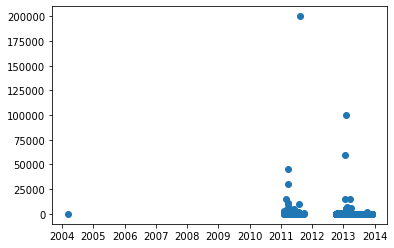

In [119]:
plt.plot_date(df_shuleni['date_recorded'],df_shuleni['amount_tsh'])

- Check to see if the water yield and the condition of the well match. (any wells that are reported as working with 0 yeild are outliers)
- water well yield could be a function of drout or other conditions as well as the condition of the water well


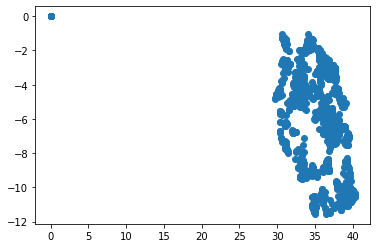

In [120]:
plt.scatter(df_shuleni['longitude'],df_shuleni['latitude'])

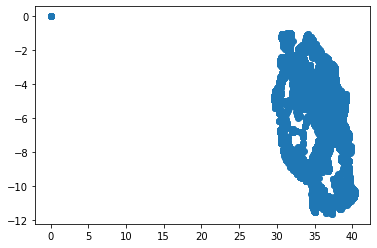

In [121]:
plt.scatter(df['longitude'],df['latitude'])

- Is the data for this one well that variable or do multiple water wells have the same name?


In [122]:
df[df['longitude'] == 0]

,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
21,functional,0.0,2013-02-10,Dwsp,0,DWE,0.0,-2.000000e-08,Muungano,0,Lake Victoria,Ibabachegu,Shinyanga,17,1,Bariadi,Ikungulyabashashi,0,False,GeoData Consultants Ltd,WUG,False,0,swn 80,swn 80,handpump,wug,user-group,unknown,unknown,unknown,unknown,unknown,unknown,shallow well,shallow well,groundwater,hand pump,hand pump
53,non functional,0.0,2011-08-01,Government Of Tanzania,0,Government,0.0,-2.000000e-08,Polisi,0,Lake Victoria,Center,Mwanza,19,6,Geita,Nyang'hwale,0,True,GeoData Consultants Ltd,VWC,True,0,submersible,submersible,submersible,vwc,user-group,unknown,unknown,unknown,unknown,dry,dry,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe
168,functional,0.0,2013-01-30,Wvt,0,WVT,0.0,-2.000000e-08,Wvt Tanzania,0,Lake Victoria,Ilula,Shinyanga,17,1,Bariadi,Chinamili,0,False,GeoData Consultants Ltd,Parastatal,False,0,gravity,gravity,gravity,parastatal,parastatal,other,other,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
177,non functional,0.0,2013-01-17,Netherlands,0,DWE,0.0,-2.000000e-08,Kikundi Cha Wakina Mama,0,Lake Victoria,Mahaha,Shinyanga,17,1,Bariadi,Bunamhala,0,False,GeoData Consultants Ltd,WUG,False,0,other,other,other,wug,user-group,unknown,unknown,soft,good,enough,enough,shallow well,shallow well,groundwater,other,other
253,functional needs repair,0.0,2012-10-29,Hesawa,0,DWE,0.0,-2.000000e-08,Kwakisusi,0,Lake Victoria,Nyamatala,Mwanza,19,2,Magu,Malili,0,True,GeoData Consultants Ltd,None,True,0,nira/tanira,nira/tanira,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59189,functional needs repair,0.0,2011-07-18,Dwsp,0,DWE,0.0,-2.000000e-08,Wazazo,0,Lake Victoria,Mwamabuli,Shinyanga,17,1,Bariadi,Mhunze,0,True,GeoData Consultants Ltd,WUG,False,0,nira/tanira,nira/tanira,handpump,wug,user-group,other,other,soft,good,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump
59208,functional,0.0,2013-01-22,Dwsp,0,DWE,0.0,-2.000000e-08,Mtakuja,0,Lake Victoria,Mbiti,Shinyanga,17,1,Bariadi,Kinang'weli,0,False,GeoData Consultants Ltd,WUG,False,0,nira/tanira,nira/tanira,handpump,wug,user-group,unknown,unknown,soft,good,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump
59295,functional needs repair,0.0,2011-07-19,Rwssp,0,DWE,0.0,-2.000000e-08,Maendeleo,0,Lake Victoria,Mwamalizi,Shinyanga,17,1,Bariadi,Chinamili,0,True,GeoData Consultants Ltd,WUG,False,0,nira/tanira,nira/tanira,handpump,wug,user-group,never pay,never pay,soft,good,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump
59324,functional,0.0,2013-01-22,World Vision,0,World Vision,0.0,-2.000000e-08,Mwazwilo,0,Lake Victoria,Mbita,Shinyanga,17,1,Bariadi,Mbita,0,False,GeoData Consultants Ltd,WUG,False,0,nira/tanira,nira/tanira,handpump,wug,user-group,unknown,unknown,soft,good,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump


In [123]:
1812/df.shape[0]

0.030505050505050504

In [124]:
df[(df['amount_tsh']==0) & (df['status_group'] == 'functional')]

,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
1,functional,0.0,2013-03-06,Grumeti,1399,GRUMETI,34.698766,-2.147466,Zahanati,0,Lake Victoria,Nyamara,Mara,20,2,Serengeti,Natta,280,False,GeoData Consultants Ltd,Other,True,2010,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
4,functional,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,None,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
9,functional,0.0,2011-08-03,Isingiro Ho,0,Artisan,30.626991,-1.257051,Kwapeto,0,Lake Victoria,Mkonomre,Kagera,18,1,Karagwe,Kaisho,0,True,GeoData Consultants Ltd,None,True,0,nira/tanira,nira/tanira,handpump,vwc,user-group,never pay,never pay,soft,good,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump
10,functional,0.0,2011-02-20,Private,62,Private,39.209518,-7.034139,Mzee Hokororo,0,Wami / Ruvu,Mizugo,Pwani,60,43,Mkuranga,Tambani,345,True,GeoData Consultants Ltd,Private operator,False,2011,submersible,submersible,submersible,private operator,commercial,never pay,never pay,salty,salty,enough,enough,machine dbh,borehole,groundwater,other,other
12,functional,0.0,2012-10-14,World Vision,0,World vision,33.798106,-3.290194,Pamba,0,Internal,Nkilifa,Shinyanga,17,2,Maswa,Busilili,0,True,GeoData Consultants Ltd,WUG,False,0,nira/tanira,nira/tanira,handpump,wug,user-group,other,other,soft,good,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59390,functional,0.0,2011-08-04,Rudep,1715,DWE,31.370848,-8.258160,Kwa Mzee Atanas,0,Lake Tanganyika,Kitonto,Rukwa,15,2,Sumbawanga Rural,Mkowe,150,True,GeoData Consultants Ltd,VWC,False,1991,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,machine dbh,borehole,groundwater,hand pump,hand pump
59393,functional,0.0,2012-10-27,Private,0,Private,33.866852,-4.287410,Kwa Peter,0,Internal,Masanga,Tabora,14,2,Igunga,Igunga,0,False,GeoData Consultants Ltd,Water authority,False,0,gravity,gravity,gravity,private operator,commercial,pay per bucket,per bucket,soft,good,insufficient,insufficient,dam,dam,surface,other,other
59397,functional,0.0,2011-04-11,missing,0,missing,34.017087,-8.750434,Mashine,0,Rufiji,Madungulu,Mbeya,12,7,Mbarali,Chimala,0,True,GeoData Consultants Ltd,VWC,False,0,swn 80,swn 80,handpump,vwc,user-group,pay monthly,monthly,fluoride,fluoride,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump
59398,functional,0.0,2011-03-08,Malec,0,Musa,35.861315,-6.378573,Mshoro,0,Rufiji,Mwinyi,Dodoma,1,4,Chamwino,Mvumi Makulu,0,True,GeoData Consultants Ltd,VWC,True,0,nira/tanira,nira/tanira,handpump,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,shallow well,shallow well,groundwater,hand pump,hand pump


In [125]:
df[df['gps_height'] == -90]

,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
58934,functional,10.0,2013-02-01,Mtuwasa,-90,MTUWASA,40.107455,-10.270643,Kwa Makumburi,0,Ruvuma / Southern Coast,Mirumba,Mtwara,9,5,Mtwara Urban,Jangwani,550,True,GeoData Consultants Ltd,Water authority,True,0,submersible,submersible,submersible,private operator,commercial,pay per bucket,per bucket,soft,good,enough,enough,machine dbh,borehole,groundwater,communal standpipe multiple,communal standpipe


The data point with alititude 90ft below sea level looks to be an actual point and will be kept.

In [126]:
df[df['construction_year'] == 0]

,status_group,amount_tsh,date_recorded,funder,gps_height,installer,longitude,latitude,wpt_name,num_private,basin,subvillage,region,region_code,district_code,lga,ward,population,public_meeting,recorded_by,scheme_management,permit,construction_year,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
4,functional,0.0,2011-07-13,Action In A,0,Artisan,31.130847,-1.825359,Shuleni,0,Lake Victoria,Kyanyamisa,Kagera,18,1,Karagwe,Nyakasimbi,0,True,GeoData Consultants Ltd,None,True,0,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
6,non functional,0.0,2012-10-01,Dwsp,0,DWSP,33.362410,-3.766365,Kwa Ngomho,0,Internal,Ishinabulandi,Shinyanga,17,3,Shinyanga Rural,Samuye,0,True,GeoData Consultants Ltd,VWC,True,0,swn 80,swn 80,handpump,vwc,user-group,never pay,never pay,soft,good,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump
7,non functional,0.0,2012-10-09,Rwssp,0,DWE,32.620617,-4.226198,Tushirikiane,0,Lake Tanganyika,Nyawishi Center,Shinyanga,17,3,Kahama,Chambo,0,True,GeoData Consultants Ltd,None,True,0,nira/tanira,nira/tanira,handpump,wug,user-group,unknown,unknown,milky,milky,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump
8,non functional,0.0,2012-11-03,Wateraid,0,Water Aid,32.711100,-5.146712,Kwa Ramadhan Musa,0,Lake Tanganyika,Imalauduki,Tabora,14,6,Tabora Urban,Itetemia,0,True,GeoData Consultants Ltd,VWC,True,0,india mark ii,india mark ii,handpump,vwc,user-group,never pay,never pay,salty,salty,seasonal,seasonal,machine dbh,borehole,groundwater,hand pump,hand pump
9,functional,0.0,2011-08-03,Isingiro Ho,0,Artisan,30.626991,-1.257051,Kwapeto,0,Lake Victoria,Mkonomre,Kagera,18,1,Karagwe,Kaisho,0,True,GeoData Consultants Ltd,None,True,0,nira/tanira,nira/tanira,handpump,vwc,user-group,never pay,never pay,soft,good,enough,enough,shallow well,shallow well,groundwater,hand pump,hand pump
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59384,non functional,0.0,2011-07-10,Concern,0,CONCERN,30.667805,-2.483710,Chamkube,0,Lake Victoria,Songambele,Kagera,18,30,Ngara,Nyamiyaga,0,True,GeoData Consultants Ltd,VWC,False,0,gravity,gravity,gravity,vwc,user-group,never pay,never pay,soft,good,insufficient,insufficient,spring,spring,groundwater,communal standpipe,communal standpipe
59392,non functional,0.0,2011-04-15,Government Of Tanzania,0,Government,33.009440,-8.520888,Benard Charles,0,Lake Rukwa,Mbuyuni A,Mbeya,12,1,Chunya,Mbuyuni,0,True,GeoData Consultants Ltd,VWC,True,0,gravity,gravity,gravity,vwc,user-group,never pay,never pay,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
59393,functional,0.0,2012-10-27,Private,0,Private,33.866852,-4.287410,Kwa Peter,0,Internal,Masanga,Tabora,14,2,Igunga,Igunga,0,False,GeoData Consultants Ltd,Water authority,False,0,gravity,gravity,gravity,private operator,commercial,pay per bucket,per bucket,soft,good,insufficient,insufficient,dam,dam,surface,other,other
59397,functional,0.0,2011-04-11,missing,0,missing,34.017087,-8.750434,Mashine,0,Rufiji,Madungulu,Mbeya,12,7,Mbarali,Chimala,0,True,GeoData Consultants Ltd,VWC,False,0,swn 80,swn 80,handpump,vwc,user-group,pay monthly,monthly,fluoride,fluoride,enough,enough,machine dbh,borehole,groundwater,hand pump,hand pump


In [127]:
df['lga'].value_counts()

Njombe          2503
Arusha Rural    1252
Moshi Rural     1251
Bariadi         1177
Rungwe          1106
                ... 
Moshi Urban       79
Kigoma Urban      71
Arusha Urban      63
Lindi Urban       21
Nyamagana          1
Name: lga, Length: 125, dtype: int64

# Feature Engineering

The features that are categorical and require OneHotEncoding but also have many different classes will be re grouped so that the top 10 will be kept and anything with a lower count will be converted to 'Other'.


In [128]:
cat = df.select_dtypes('object')

In [129]:
list(df['funder'].value_counts()[:10].index)

['Government Of Tanzania',
 'missing',
 'Danida',
 'Hesawa',
 'Rwssp',
 'World Bank',
 'Kkkt',
 'World Vision',
 'Unicef',
 'Tasaf']

In [130]:
# look at the overall count of unique classes for each feature
for i in cat.columns:

        print('{} : {}'.format(i,cat[i].value_counts().shape[0]))
        

status_group : 3
funder : 1898
installer : 2146
wpt_name : 37400
basin : 9
subvillage : 19288
region : 21
lga : 125
ward : 2092
recorded_by : 1
scheme_management : 12
extraction_type : 18
extraction_type_group : 13
extraction_type_class : 7
management : 12
management_group : 5
payment : 7
payment_type : 7
water_quality : 8
quality_group : 6
quantity : 5
quantity_group : 5
source : 10
source_type : 7
source_class : 3
waterpoint_type : 7
waterpoint_type_group : 6


In [131]:
cols = cat.columns
df[cols] = df[cols].where(df[cols].apply(lambda x: x.map(x.value_counts())) >= 50, 'other')

In [132]:
for i in cat.columns:
    print('{} : {}'.format(i,df[i].value_counts().shape[0]))

status_group : 3
funder : 146
installer : 146
wpt_name : 37
basin : 9
subvillage : 62
region : 21
lga : 124
ward : 322
recorded_by : 1
scheme_management : 12
extraction_type : 15
extraction_type_group : 13
extraction_type_class : 7
management : 12
management_group : 5
payment : 7
payment_type : 7
water_quality : 8
quality_group : 6
quantity : 5
quantity_group : 5
source : 10
source_type : 7
source_class : 3
waterpoint_type : 6
waterpoint_type_group : 5


- engineering binned age column

In [134]:
basedate = datetime(2021, 6, 24)
a = list(range(1960,2020,5))
cut_bins = [-1]
cut_bins.extend(a)
cut_labels = ['not available','61-65','66-70','71-75','76-80','81-85','86-90','91-95','96-00','01-05','06-10','11-15']
df.loc[:, 'construction_year_bin'] = pd.cut(df['construction_year'], bins = cut_bins, labels = cut_labels)

In [135]:
df['construction_year_bin'].value_counts()

not available    20811
06-10            10849
96-00             5491
01-05             5035
91-95             3324
81-85             3194
76-80             2656
86-90             2527
11-15             2516
71-75             2150
66-70              652
61-65              195
Name: construction_year_bin, dtype: int64

In [136]:
df.drop('construction_year',axis=1,inplace=True)

In [140]:
df.drop('date_recorded',axis=1,inplace=True)

We want to convert the date of recording to season of recording to see if water wells have a higher rate of breaking down depending on the season.

In [155]:
#Define get_season function to use in .map() to get the seasons.

# Y = 2000 # dummy leap year to allow input X-02-29 (leap day)
# seasons = [('winter', (date(Y,  1,  1),  date(Y,  3, 20))),
#            ('spring', (date(Y,  3, 21),  date(Y,  6, 20))),
#            ('summer', (date(Y,  6, 21),  date(Y,  9, 22))),
#            ('autumn', (date(Y,  9, 23),  date(Y, 12, 20))),
#            ('winter', (date(Y, 12, 21),  date(Y, 12, 31)))]

# def get_season(date):
#     if isinstance(date, datetime):
#         date = date.date()
#     date = date.replace(year=Y)
#     return next(season for season, (start, end) in seasons
#                 if start <= date <= end)

Table with the new features and explanations of the physical parameters.

# Exploratory Data Analysis

### Table of Contents with the Types of Analyses Done

In [46]:
# Pre-Set the style of our charts
mpl.style.use('fivethirtyeight')

In [47]:
# Code with the relevant chart for the target feature.
continuous = df.select_dtypes(include=['int64','float64'])

In [48]:
continuous

,amount_tsh,gps_height,longitude,latitude,num_private,region_code,district_code,population,construction_year
0,6000.0,1390,34.938093,-9.856322,0,11,5,109,1999
1,0.0,1399,34.698766,-2.147466,0,20,2,280,2010
2,25.0,686,37.460664,-3.821329,0,21,4,250,2009
3,0.0,263,38.486161,-11.155298,0,90,63,58,1986
4,0.0,0,31.130847,-1.825359,0,18,1,0,0
...,...,...,...,...,...,...,...,...,...
59395,10.0,1210,37.169807,-3.253847,0,3,5,125,1999
59396,4700.0,1212,35.249991,-9.070629,0,11,4,56,1996
59397,0.0,0,34.017087,-8.750434,0,12,7,0,0
59398,0.0,0,35.861315,-6.378573,0,1,4,0,0


In [8]:
functional_cats = df[(df['status_group'] == 'functional') & (df['water_quality'] != 'other')].select_dtypes('object')
not_functional_cats = df[(df['status_group'] == 'non functional') & (df['water_quality'] != 'other')].select_dtypes('object')
functional_needs_repair_cats = df[(df['status_group'] == 'functional needs repair') & (df['water_quality'] != 'other')].select_dtypes('object')

In [9]:
functional_cats.groupby('water_quality').count()['extraction_type'].index

Index(['coloured', 'fluoride', 'milky', 'salty', 'salty abandoned', 'soft',
       'unknown'],
      dtype='object', name='water_quality')

In [10]:
functional_cats.columns

Index(['status_group', 'funder', 'installer', 'wpt_name', 'basin',
       'subvillage', 'region', 'lga', 'ward', 'recorded_by',
       'scheme_management', 'scheme_name', 'permit', 'extraction_type',
       'extraction_type_group', 'extraction_type_class', 'management',
       'management_group', 'payment', 'payment_type', 'water_quality',
       'quality_group', 'quantity', 'quantity_group', 'source', 'source_type',
       'source_class', 'waterpoint_type', 'waterpoint_type_group'],
      dtype='object')

In [15]:
functional_cats.groupby('water_quality').count()

,status_group,funder,installer,wpt_name,basin,subvillage,region,lga,ward,recorded_by,scheme_management,scheme_name,permit,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
water_quality,,,,,,,,,,,,,,,,,,,,,,,,,,,,
coloured,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246,246
fluoride,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150,150
milky,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437,437
salty,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193,2193
salty abandoned,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126,126
soft,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983,27983
unknown,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250,250


In [10]:
functional_cats = df[(df['status_group'] == 'functional')].select_dtypes('object')
not_functional_cats = df[(df['status_group'] == 'non functional')].select_dtypes('object')
functional_needs_repair_cats = df[(df['status_group'] == 'functional needs repair')].select_dtypes('object')

In [11]:
functional_cats.head()

,status_group,funder,installer,wpt_name,basin,subvillage,region,lga,ward,recorded_by,scheme_management,scheme_name,permit,extraction_type,extraction_type_group,extraction_type_class,management,management_group,payment,payment_type,water_quality,quality_group,quantity,quantity_group,source,source_type,source_class,waterpoint_type,waterpoint_type_group
0,functional,Roman,Roman,none,Lake Nyasa,Mnyusi B,Iringa,Ludewa,Mundindi,GeoData Consultants Ltd,VWC,Roman,False,gravity,gravity,gravity,vwc,user-group,pay annually,annually,soft,good,enough,enough,spring,spring,groundwater,communal standpipe,communal standpipe
1,functional,Grumeti,GRUMETI,Zahanati,Lake Victoria,Nyamara,Mara,Serengeti,Natta,GeoData Consultants Ltd,Other,None,True,gravity,gravity,gravity,wug,user-group,never pay,never pay,soft,good,insufficient,insufficient,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
2,functional,Lottery Club,World vision,Kwa Mahundi,Pangani,Majengo,Manyara,Simanjiro,Ngorika,GeoData Consultants Ltd,VWC,Nyumba ya mungu pipe scheme,True,gravity,gravity,gravity,vwc,user-group,pay per bucket,per bucket,soft,good,enough,enough,dam,dam,surface,communal standpipe multiple,communal standpipe
4,functional,Action In A,Artisan,Shuleni,Lake Victoria,Kyanyamisa,Kagera,Karagwe,Nyakasimbi,GeoData Consultants Ltd,None,None,True,gravity,gravity,gravity,other,other,never pay,never pay,soft,good,seasonal,seasonal,rainwater harvesting,rainwater harvesting,surface,communal standpipe,communal standpipe
5,functional,Mkinga Distric Coun,DWE,Tajiri,Pangani,Moa/Mwereme,Tanga,Mkinga,Moa,GeoData Consultants Ltd,VWC,Zingibali,True,submersible,submersible,submersible,vwc,user-group,pay per bucket,per bucket,salty,salty,enough,enough,other,other,unknown,communal standpipe multiple,communal standpipe


KeyError: 'status_group'

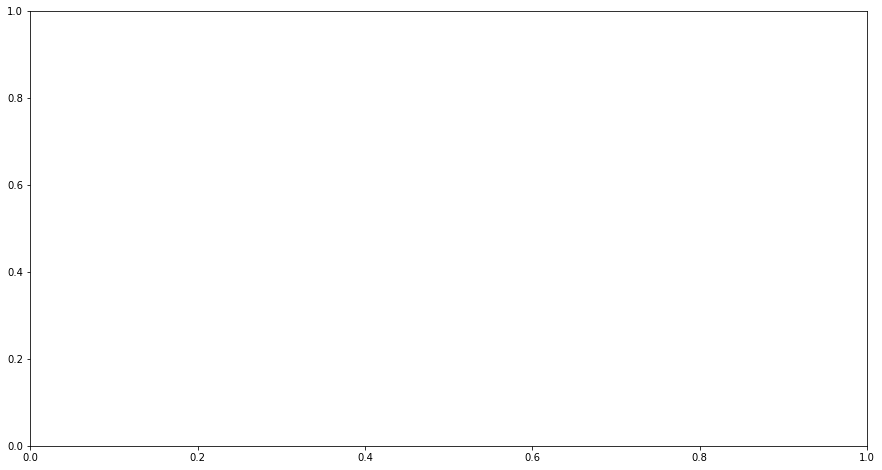

In [8]:

for col in df.select_dtypes('object').columns:

    functional_cats = df[(df['status_group'] == 'functional')].select_dtypes('object')
    not_functional_cats = df[(df['status_group'] == 'non functional')].select_dtypes('object')
    functional_needs_repair_cats = df[(df['status_group'] == 'functional needs repair')].select_dtypes('object')
    
    fig,ax = plt.subplots(figsize=(15,8)) 
    width = 0.3
    n = len(functional_cats.groupby(col).count()['status_group'].index)
    r = np.arange(n)

    x_func = functional_cats.groupby(col).count()['status_group'].index
    y_func = functional_cats.groupby(col).count()['status_group'].values
    x_func_rep = functional_needs_repair_cats.groupby(col).count()['status_group'].index
    y_func_rep = functional_needs_repair_cats.groupby(col).count()['status_group'].values
    x_not_func = not_functional_cats.groupby(col).count()['status_group'].index
    y_not_func = not_functional_cats.groupby(col).count()['status_group'].values

    ax.bar(r,y_func,width=width,align='edge')
    ax.bar(r-width,y_func_rep,width=width,align='edge')
    ax.bar(r+width,y_not_func,width=width,align='edge')
    plt.xticks(r + width/2,list(functional_cats.groupby(col).count()['status_group'].index))
    ax.set_title('Water Quality vs. Water Point Function')
    ax.set_xlabel('Water Quality')
    ax.set_ylabel('Number of Water Points')
    ax.legend(['functional','non functional','functional needs repair'])
    plt.tight_layout()

    fig.savefig('../images/water_quality.png');
    
    

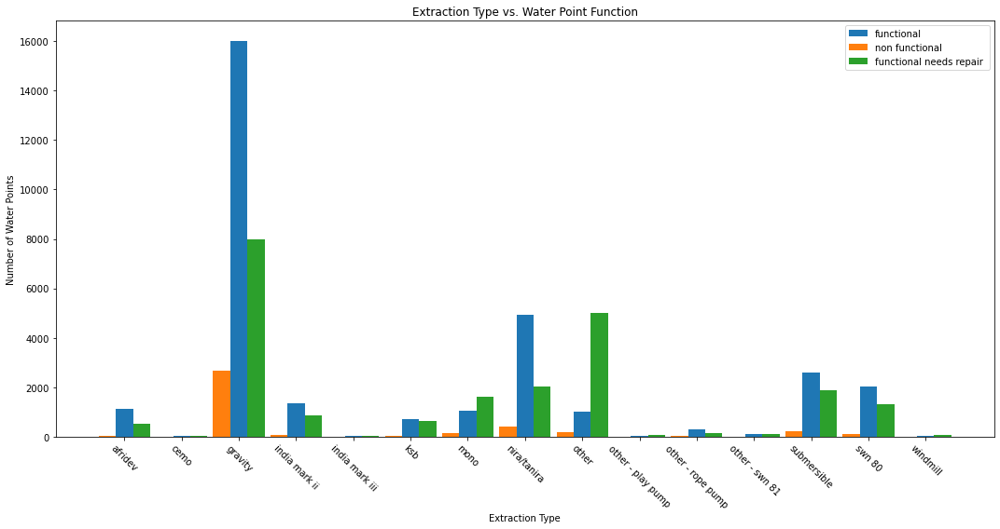

In [17]:
fig,ax = plt.subplots(figsize=(15,8)) 
width = 0.3
n = len(functional_cats.groupby('extraction_type').count()['funder'].index)
r = np.arange(n)

x_func = functional_cats.groupby('extraction_type').count()['funder'].index
y_func = functional_cats.groupby('extraction_type').count()['funder'].values
x_func_rep = functional_needs_repair_cats.groupby('extraction_type').count()['funder'].index
y_func_rep = functional_needs_repair_cats.groupby('extraction_type').count()['funder'].values
x_not_func = not_functional_cats.groupby('extraction_type').count()['funder'].index
y_not_func = not_functional_cats.groupby('extraction_type').count()['funder'].values

ax.bar(r,y_func,width=width,align='edge')
ax.bar(r-width,y_func_rep,width=width,align='edge')
ax.bar(r+width,y_not_func,width=width,align='edge')
plt.xticks(r + width/2,list(functional_cats.groupby('extraction_type').count()['funder'].index),rotation=-45)
ax.set_title('Extraction Type vs. Water Point Function')
ax.set_xlabel('Extraction Type')
ax.set_ylabel('Number of Water Points')
ax.legend(['functional','non functional','functional needs repair '])
plt.tight_layout()

fig.savefig('../images/extraction_type.png');

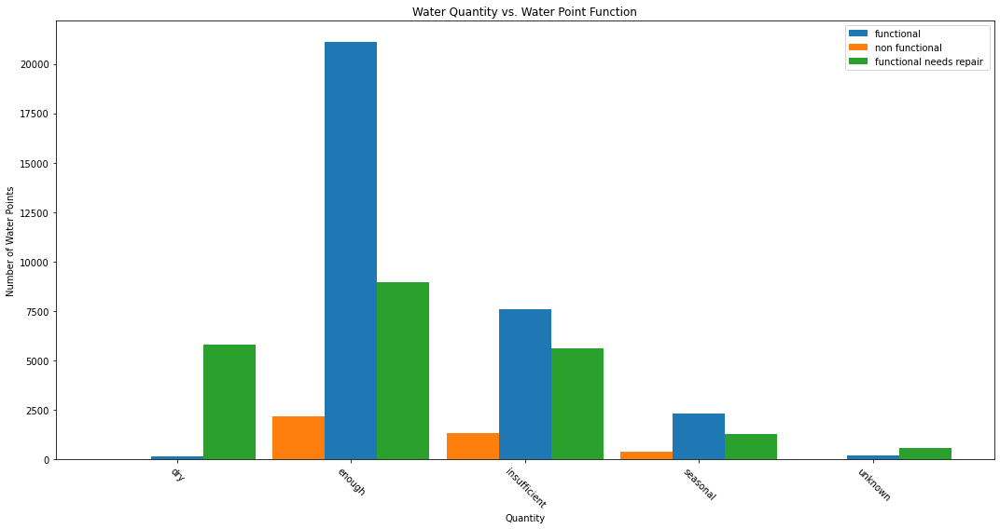

In [13]:
fig,ax = plt.subplots(figsize=(15,8)) 
width = 0.3
n = len(functional_cats.groupby('quantity').count()['funder'].index)
r = np.arange(n)

x_func = functional_cats.groupby('quantity').count()['funder'].index
y_func = functional_cats.groupby('quantity').count()['funder'].values
x_func_rep = functional_needs_repair_cats.groupby('quantity').count()['funder'].index
y_func_rep = functional_needs_repair_cats.groupby('quantity').count()['funder'].values
x_not_func = not_functional_cats.groupby('quantity').count()['funder'].index
y_not_func = not_functional_cats.groupby('quantity').count()['funder'].values

ax.bar(r,y_func,width=width,align='edge')
ax.bar(r-width,y_func_rep,width=width,align='edge')
ax.bar(r+width,y_not_func,width=width,align='edge')
plt.xticks(r + width/2,list(functional_cats.groupby('quantity').count()['funder'].index),rotation=-45)
ax.set_title('Water Quantity vs. Water Point Function')
ax.set_xlabel('Quantity')
ax.set_ylabel('Number of Water Points')
ax.legend(['functional','non functional','functional needs repair '])
plt.tight_layout()

fig.savefig('../images/water_quantity.png');

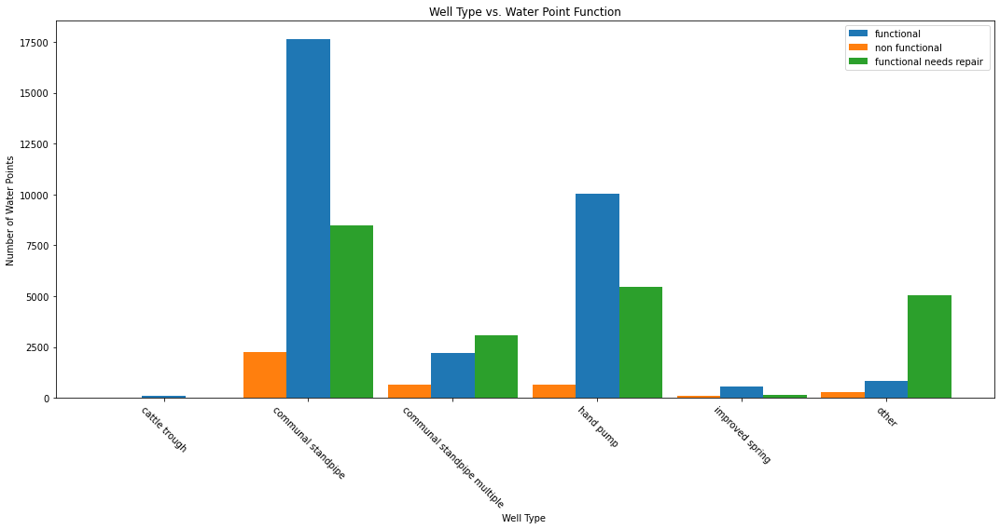

In [14]:
fig,ax = plt.subplots(figsize=(15,8)) 
width = 0.3
n = len(functional_cats.groupby('waterpoint_type').count()['funder'].index)
r = np.arange(n)

x_func = functional_cats.groupby('waterpoint_type').count()['funder'].index
y_func = functional_cats.groupby('waterpoint_type').count()['funder'].values
x_func_rep = functional_needs_repair_cats.groupby('waterpoint_type').count()['funder'].index
y_func_rep = functional_needs_repair_cats.groupby('waterpoint_type').count()['funder'].values
x_not_func = not_functional_cats.groupby('waterpoint_type').count()['funder'].index
y_not_func = not_functional_cats.groupby('waterpoint_type').count()['funder'].values

ax.bar(r,y_func,width=width,align='edge')
ax.bar(r-width,y_func_rep,width=width,align='edge')
ax.bar(r+width,y_not_func,width=width,align='edge')
plt.xticks(r + width/2,list(functional_cats.groupby('waterpoint_type').count()['funder'].index),rotation=-45)
ax.set_title('Well Type vs. Water Point Function')
ax.set_xlabel('Well Type ')
ax.set_ylabel('Number of Water Points')
ax.legend(['functional','non functional','functional needs repair '])
plt.tight_layout()

fig.savefig('../images/well_type.png');

In [54]:
df['log_population'] = np.log(df['population']+0.1)

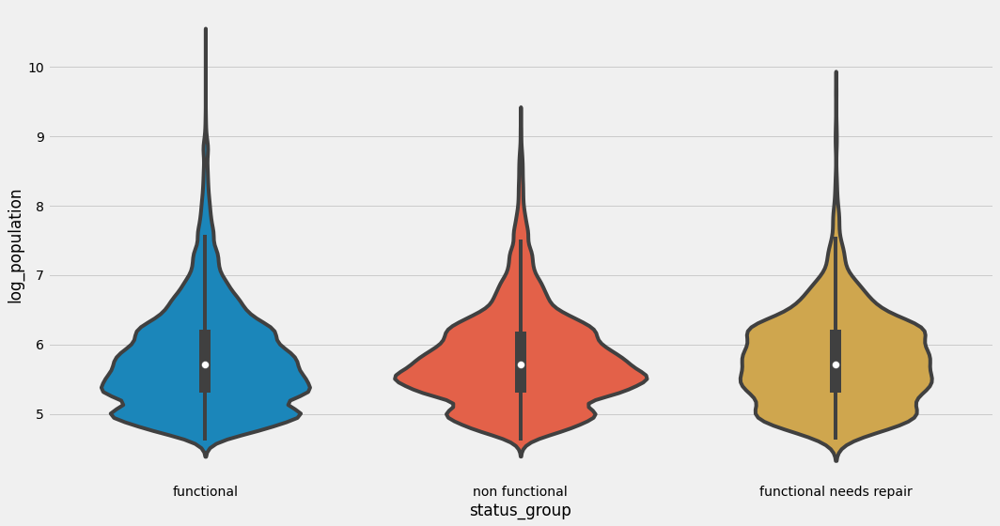

In [81]:
fig, ax = plt.subplots(figsize = (15,8))
sns.violinplot(x='status_group',y='log_population',data=df[df['population']>100],order=['functional','non functional','functional needs repair'])
plt.tight_layout()

fig.savefig('../images/population.png');

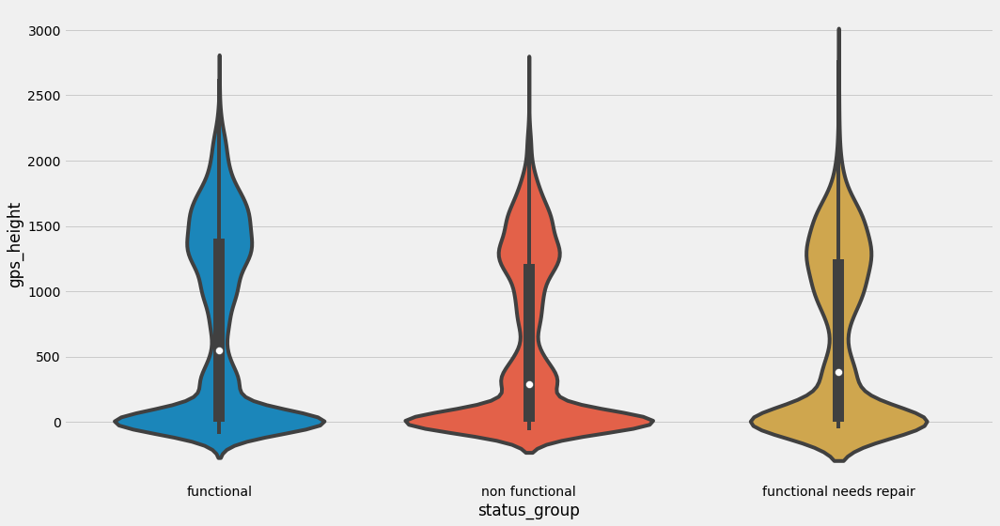

In [82]:
fig, ax = plt.subplots(figsize = (15,8))
sns.violinplot(x='status_group',y='gps_height',data=df,order=['functional','non functional','functional needs repair'])
plt.tight_layout()

fig.savefig('../images/altitude.png');

In [84]:
df_amount = df[df['amount_tsh'] > 500]
df_amount['log_amount'] = np.log10(df['amount_tsh'])

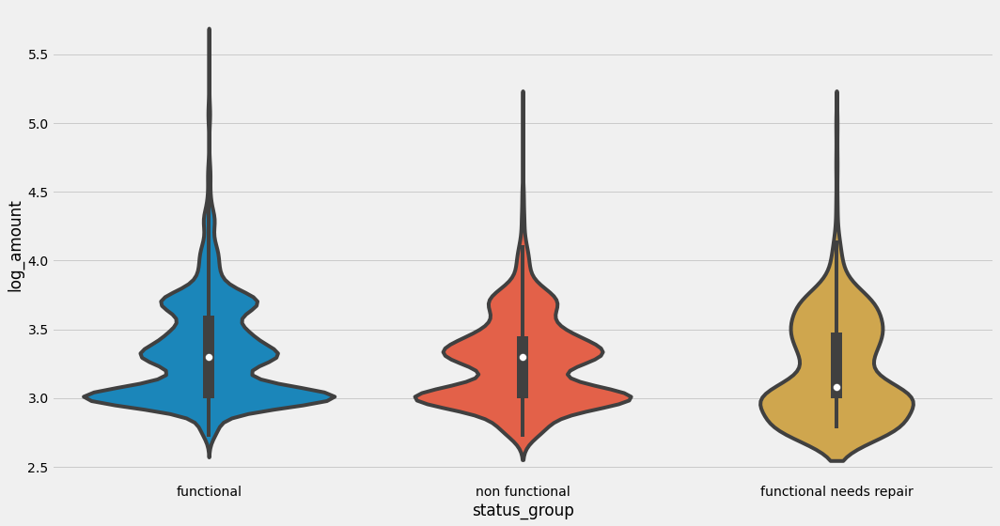

In [85]:
fig, ax = plt.subplots(figsize = (15,8))

sns.violinplot(x='status_group',y='log_amount',data=df_amount,order=['functional','non functional','functional needs repair'])

plt.tight_layout()

fig.savefig('../images/water_amount.png');

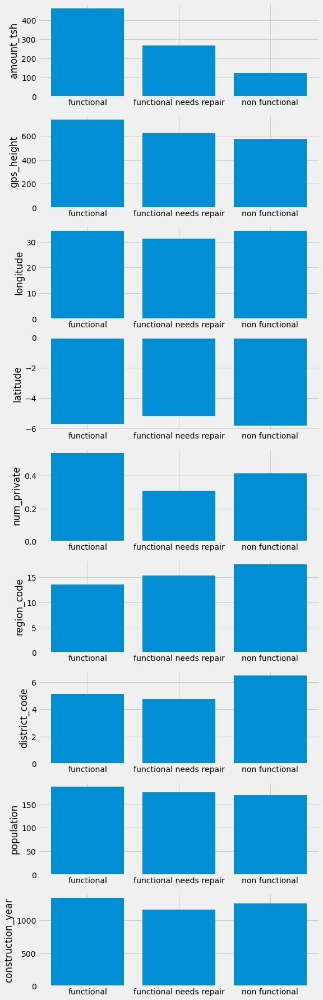

In [59]:
fig,ax = plt.subplots(len(continuous.columns),1,figsize=(8,30)) 
n = 0
for i in continuous:

    f =  df.groupby('status_group').mean()[i].values
    g =  df.groupby('status_group').mean()[i].index
    ax[n].bar(g,f)
    ax[n].set_ylabel(i)
    n+=1

Target has a correlation with the popultaion, the gps hieght, and the water yield

In [60]:
df_geo = df[df['longitude'] != 0]

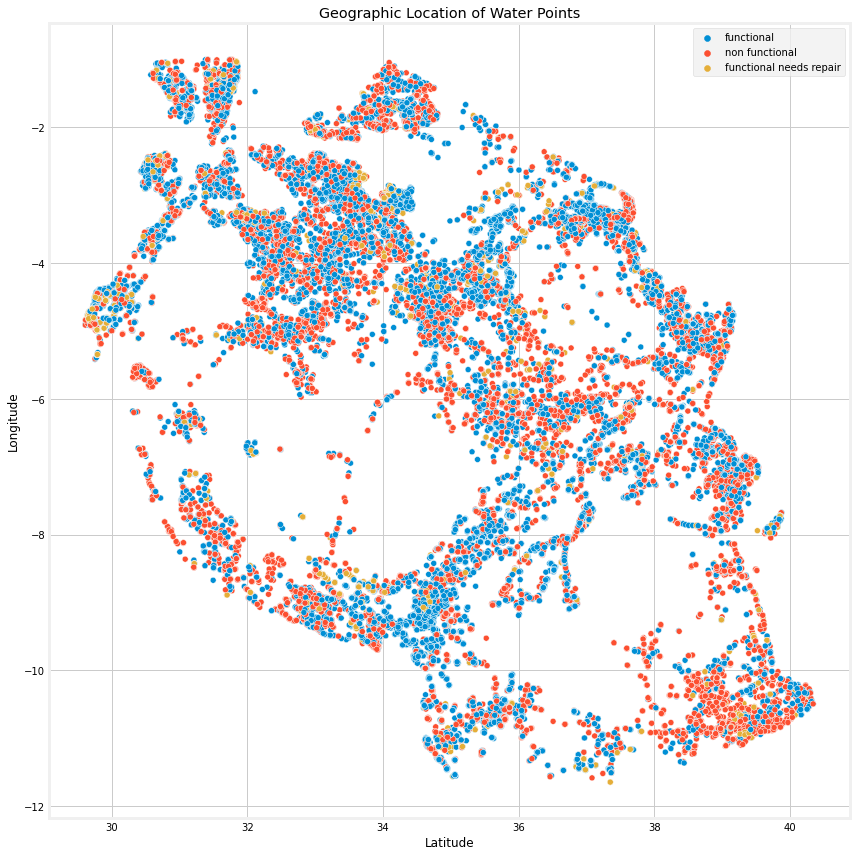

In [188]:
# Create scatter
fig1, ax = plt.subplots(figsize = (12,12))

x1 = df_geo['longitude']
y1 = df_geo['latitude']

#Build scatterplot
scatter = sns.scatterplot(x1,y1, hue = df_geo['status_group'])
ax.set_xlabel("Latitude")
ax.set_ylabel("Longitude")
ax.set_title('Geographic Location of Water Points')
plt.ticklabel_format(style = 'plain', axis = 'y')
plt.tight_layout()
plt.legend(loc='upper right')
ax.patch.set_alpha(0)
#Save fig
fig1.savefig('../images/well_function_location.png');

In [ ]:
locations = list(zip(df['latitude'], df['longitude']))


In [466]:
hmap = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=10, )
for point in range(0,len(locations)):
    folium.Marker(locations[point]).add_to(hmap)#, popup=df_geo['status_group'][point]
    
hmap

In [ ]:
# #Create Barchart

# fig2, ax = plt.subplots(figsize = (8,8))

# x1 = ['Not Waterfront', 'Waterfront']
# y1 = df.groupby('waterfront').mean()['price'].values

# #Build barplot
# sns.barplot(x1,y1)

# ax.set_ylabel("Sale Price")
# ax.set_title('Sale Price of Waterfront vs Non-Waterfront')

# plt.ticklabel_format(style = 'plain', axis = 'y')
# plt.tight_layout()

# #Save Fig
# fig2.savefig('images/sales_per_waterfront.png');

In [439]:
#Define the max value to be used in the heatmap
max_amount = df['amount_tsh'].max()

#Create the basemap using the general lat, long coordinates of King County
hmap = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=10, )

#Create the heatmap
hm_wide = HeatMap(list(zip(df['latitude'], df['longitude'], df['amount_tsh'])),#
                   min_opacity=0.0001,
                   max_val=max_amount,
                   radius=7, blur=10, 
                   max_zoom=1, 
                 )

#layer the heatmap over the basemap
hmap.add_child(hm_wide)

In [40]:
pop = df['population'].astype('float')

In [41]:
pop

0        109.0
1        280.0
2        250.0
3         58.0
4          0.0
         ...  
59395    125.0
59396     56.0
59397      0.0
59398      0.0
59399    150.0
Name: population, Length: 59400, dtype: float64

In [42]:
#Define the max value to be used in the heatmap
max_amount = pop.max()

#Create the basemap using the general lat, long coordinates of King County
hmap = folium.Map(location=[df['latitude'].mean(), df['longitude'].mean()], zoom_start=10, )

#Create the heatmap
hm_wide = HeatMap(list(zip(df['latitude'], df['longitude'], pop)),
                   min_opacity=0.0001,
                   max_val=max_amount,
                   radius=7, blur=10, 
                   max_zoom=1, 
                 )

#layer the heatmap over the basemap
hmap.add_child(hm_wide)

In [43]:
# # Create Interactive ZipCode Map

# #We need to convert zipcode to a string so it can interact with our json file
# df['district_code'] = df['district_code'].astype('str')

# #Grab the geo json file from the king county website and save it to a folder in the repository
# king_file = "../geojson_files/TZA_adm1_mkoaTZ.geojson"
# with open(king_file, 'r') as f:
#     boundary = json.load(f)

# # create the folium map using general king county lat and long  
# m = folium.Map(location=[47.5480, -121.9836], zoom_start=10, tiles='Stamen Toner')


# # Use the groupby method to get mean value for price
# zipcode_data = df.groupby('district_code').aggregate(np.mean)
# zipcode_data.reset_index(inplace = True)


# # Create choropleth map  
# folium.Choropleth(
#     geo_data=boundary,
#     name='choropleth',
#     data=zipcode_data,
#     columns=['district_code', 'amount_tsh'],
#     key_on='feature.properties.',
#     fill_color='Spectral',
#     fill_opacity=0.6,
#     nan_fill_opacity=0,
#     line_opacity=1,
#     #bins=bins,
#     legend_name='Mean Water Yield'
# ).add_to(m)

# #Create popups for the area code and average price
# for i in range(0,len(zipcode_data)):
#     folium.Marker(
#     location=[zipcode_data.iloc[i]['latitude'], zipcode_data.iloc[i]['longitude']],
#     #icon=icon,
#     radius=float(15000.0),
#     popup="ZipCode: "+ str(zipcode_data.iloc[i]['district_code'])+" Average Price: $"+str(round(int(zipcode_data.iloc[i]['amount_tsh']),0))
#     ).add_to(m)
# m


# Modeling

Table of contents describing the different models used

## Vanilla Models

### Decision Tree

In [141]:
stat_map = {'functional':2,'functional needs repair':1,'non functional':0}
df['status_group'] = df['status_group'].map(stat_map)

In [143]:
df.drop(['wpt_name','recorded_by'],axis=1,inplace=True)
df = df[df['longitude'] != 0]

In [144]:
# separate features and target
X = df.drop('status_group',axis=1)
y = df['status_group']

In [145]:
X.columns

Index(['amount_tsh', 'funder', 'gps_height', 'installer', 'longitude',
       'latitude', 'num_private', 'basin', 'subvillage', 'region',
       'region_code', 'district_code', 'lga', 'ward', 'population',
       'public_meeting', 'scheme_management', 'permit', 'extraction_type',
       'extraction_type_group', 'extraction_type_class', 'management',
       'management_group', 'payment', 'payment_type', 'water_quality',
       'quality_group', 'quantity', 'quantity_group', 'source', 'source_type',
       'source_class', 'waterpoint_type', 'waterpoint_type_group',
       'construction_year_bin'],
      dtype='object')

In [146]:
#train test split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size = 0.33,random_state=42)

In [147]:
X_train_cat = X_train.select_dtypes('object')
X_test_cat = X_test.select_dtypes('object')

In [148]:
X_train_con = X_train.select_dtypes('float64')
X_test_con = X_test.select_dtypes('float64')

In [149]:
clmntr = ColumnTransformer([('ohe',OneHotEncoder(sparse=False,handle_unknown='ignore'),list(X_train_cat.columns)),
                            ('ss',StandardScaler(),list(X_train_con.columns) )])

# Decision Tree

In [150]:
# Create model and see summary output
from imblearn.pipeline import Pipeline as ImbPipe
from imblearn.over_sampling import SMOTE

pipe_imb = ImbPipe([('trsfm',clmntr),
                ('sm',SMOTE(random_state=42)),
                ('dtree',DecisionTreeClassifier(random_state=42))])#

pipe_imb.fit(X_train,y_train)

Pipeline(steps=[('trsfm',
                 ColumnTransformer(transformers=[('ohe',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  ['funder', 'installer',
                                                   'basin', 'subvillage',
                                                   'region', 'lga', 'ward',
                                                   'scheme_management',
                                                   'extraction_type',
                                                   'extraction_type_group',
                                                   'extraction_type_class',
                                                   'management',
                                                   'management_group',
                                                   'payment', 'payment_type',
                 

Evaluation Metrics: Train Data

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     14949
           1       1.00      1.00      1.00      2607
           2       1.00      1.00      1.00     21027

    accuracy                           1.00     38583
   macro avg       1.00      1.00      1.00     38583
weighted avg       1.00      1.00      1.00     38583

---------------------------------------------

Evaluation Metrics: Test Data

              precision    recall  f1-score   support

           0       0.75      0.76      0.76      7319
           1       0.35      0.42      0.38      1324
           2       0.81      0.78      0.79     10362

    accuracy                           0.75     19005
   macro avg       0.64      0.65      0.64     19005
weighted avg       0.75      0.75      0.75     19005



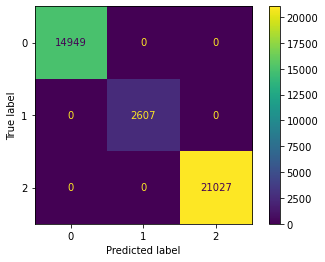

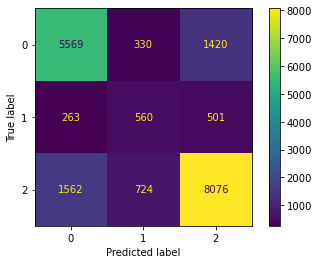

In [151]:
y_hat_train = pipe_imb.predict(X_train)
y_hat_test = pipe_imb.predict(X_test)

print('Evaluation Metrics: Train Data\n')
print(classification_report(y_train,y_hat_train))
print('---------------------------------------------\n')
print('Evaluation Metrics: Test Data\n')
print(classification_report(y_test,y_hat_test))

plot_confusion_matrix(pipe_imb,X_train,y_train)
plot_confusion_matrix(pipe_imb,X_test,y_test)

In [ ]:
feature_names = list(pipe_imb.named_steps['trsfm'].transformers_[0][1].get_feature_names(X_train.select_dtypes('object').columns))#
feature_names = feature_names + pipe_imb.named_steps['trsfm'].transformers_[1][2]
feature_dict = dict(zip(feature_names,pipe_imb.steps[2][1].feature_importances_))

feature_dict_sorted = {k: v for k, v in sorted(feature_dict.items(), key=lambda item: item[1], reverse = True)}

names = list(feature_dict_sorted.keys())[:20]
vals = list(feature_dict_sorted.values())[:20]

fig, ax = plt.subplots(figsize = (15,8))
plt.barh(names, vals)
plt.title('Feature Importance')
ax.set_xlabel('Feature Weights')
ax.set_ylabel('Features')
plt.tight_layout()
fig.savefig('../images/feature_importance.png');

# Logistic Regression

In [152]:
pipe_lr_imb = ImbPipe([('trsfm',clmntr),
                   ('sm',SMOTE(random_state=42)),
                   ('lr',LogisticRegression(random_state=42))])#
pipe_lr_imb.fit(X_train,y_train)

Pipeline(steps=[('trsfm',
                 ColumnTransformer(transformers=[('ohe',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  ['funder', 'installer',
                                                   'basin', 'subvillage',
                                                   'region', 'lga', 'ward',
                                                   'scheme_management',
                                                   'extraction_type',
                                                   'extraction_type_group',
                                                   'extraction_type_class',
                                                   'management',
                                                   'management_group',
                                                   'payment', 'payment_type',
                 

Evaluation Metrics: Train Data

              precision    recall  f1-score   support

           0       0.79      0.69      0.74     14949
           1       0.23      0.75      0.35      2607
           2       0.83      0.66      0.74     21027

    accuracy                           0.68     38583
   macro avg       0.61      0.70      0.61     38583
weighted avg       0.77      0.68      0.71     38583

---------------------------------------------

Evaluation Metrics: Test Data

              precision    recall  f1-score   support

           0       0.77      0.69      0.72      7319
           1       0.21      0.68      0.32      1324
           2       0.82      0.65      0.73     10362

    accuracy                           0.67     19005
   macro avg       0.60      0.67      0.59     19005
weighted avg       0.76      0.67      0.70     19005



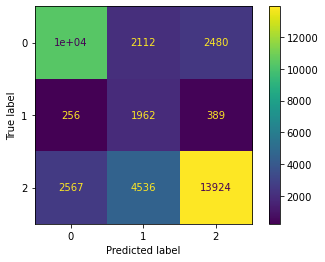

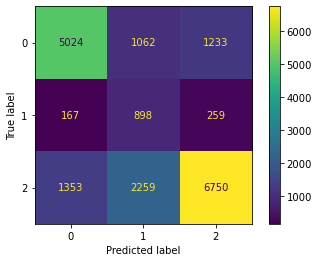

In [153]:
y_hat_train = pipe_lr_imb.predict(X_train)
y_hat_test = pipe_lr_imb.predict(X_test)

print('Evaluation Metrics: Train Data\n')
print(classification_report(y_train,y_hat_train))
print('---------------------------------------------\n')
print('Evaluation Metrics: Test Data\n')
print(classification_report(y_test,y_hat_test))

plot_confusion_matrix(pipe_lr_imb,X_train,y_train)
plot_confusion_matrix(pipe_lr_imb,X_test,y_test)

# KNN Classifier

In [154]:
pipe_knn = ImbPipe([('trsfm',clmntr),
                     ('sm',SMOTE(random_state=42)),
                     ('lr',KNeighborsClassifier())])#
pipe_knn.fit(X_train,y_train)

Pipeline(steps=[('trsfm',
                 ColumnTransformer(transformers=[('ohe',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  ['funder', 'installer',
                                                   'basin', 'subvillage',
                                                   'region', 'lga', 'ward',
                                                   'scheme_management',
                                                   'extraction_type',
                                                   'extraction_type_group',
                                                   'extraction_type_class',
                                                   'management',
                                                   'management_group',
                                                   'payment', 'payment_type',
                 

Evaluation Metrics: Train Data

              precision    recall  f1-score   support

           0       0.85      0.85      0.85     14949
           1       0.44      0.88      0.59      2607
           2       0.91      0.80      0.85     21027

    accuracy                           0.82     38583
   macro avg       0.73      0.84      0.76     38583
weighted avg       0.86      0.82      0.83     38583

---------------------------------------------

Evaluation Metrics: Test Data

              precision    recall  f1-score   support

           0       0.76      0.76      0.76      7319
           1       0.27      0.58      0.36      1324
           2       0.84      0.71      0.77     10362

    accuracy                           0.72     19005
   macro avg       0.62      0.68      0.63     19005
weighted avg       0.77      0.72      0.74     19005



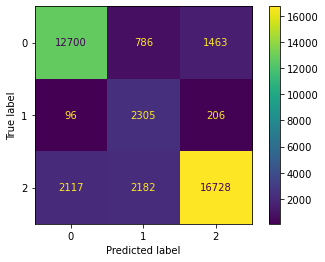

In [155]:
y_hat_train = pipe_knn.predict(X_train)
y_hat_test = pipe_knn.predict(X_test)

print('Evaluation Metrics: Train Data\n')
print(classification_report(y_train,y_hat_train))
print('---------------------------------------------\n')
print('Evaluation Metrics: Test Data\n')
print(classification_report(y_test,y_hat_test))

plot_confusion_matrix(pipe_knn,X_train,y_train)
plot_confusion_matrix(pipe_knn,X_test,y_test)

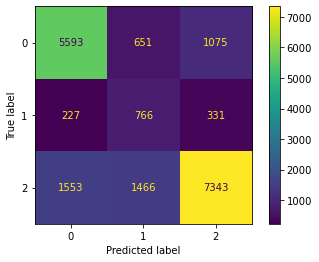

In [160]:
plot_confusion_matrix(pipe_knn,X_test,y_test)

# Bagging

In [156]:
pipe_bag = ImbPipe([('trsfm',clmntr),
                     ('sm',SMOTE(random_state=42)),
                     ('lr',BaggingClassifier(n_estimators=100,verbose=1,random_state=42))])#
pipe_bag.fit(X_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed: 10.3min finished


Pipeline(steps=[('trsfm',
                 ColumnTransformer(transformers=[('ohe',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  ['funder', 'installer',
                                                   'basin', 'subvillage',
                                                   'region', 'lga', 'ward',
                                                   'scheme_management',
                                                   'extraction_type',
                                                   'extraction_type_group',
                                                   'extraction_type_class',
                                                   'management',
                                                   'management_group',
                                                   'payment', 'payment_type',
                 

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   37.3s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   17.5s finished


Evaluation Metrics: Train Data

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     14949
           1       1.00      1.00      1.00      2607
           2       1.00      1.00      1.00     21027

    accuracy                           1.00     38583
   macro avg       1.00      1.00      1.00     38583
weighted avg       1.00      1.00      1.00     38583

---------------------------------------------

Evaluation Metrics: Test Data

              precision    recall  f1-score   support

           0       0.80      0.78      0.79      7319
           1       0.39      0.43      0.41      1324
           2       0.82      0.82      0.82     10362

    accuracy                           0.78     19005
   macro avg       0.67      0.68      0.67     19005
weighted avg       0.78      0.78      0.78     19005



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   37.1s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   17.4s finished


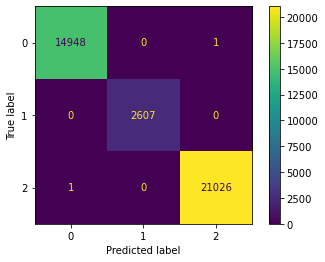

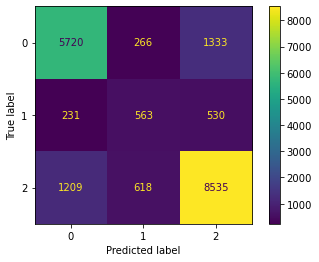

In [157]:
y_hat_train = pipe_bag.predict(X_train)
y_hat_test = pipe_bag.predict(X_test)

print('Evaluation Metrics: Train Data\n')
print(classification_report(y_train,y_hat_train))
print('---------------------------------------------\n')
print('Evaluation Metrics: Test Data\n')
print(classification_report(y_test,y_hat_test))

plot_confusion_matrix(pipe_bag,X_train,y_train)
plot_confusion_matrix(pipe_bag,X_test,y_test)

# Random Forest

In [158]:
pipe_rf = ImbPipe([('trsfm',clmntr),
                    ('sm',SMOTE(random_state=42)),
                    ('rf',RandomForestClassifier())])
pipe_rf.fit(X_train,y_train)

Pipeline(steps=[('trsfm',
                 ColumnTransformer(transformers=[('ohe',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  ['funder', 'installer',
                                                   'basin', 'subvillage',
                                                   'region', 'lga', 'ward',
                                                   'scheme_management',
                                                   'extraction_type',
                                                   'extraction_type_group',
                                                   'extraction_type_class',
                                                   'management',
                                                   'management_group',
                                                   'payment', 'payment_type',
                 

Evaluation Metrics: Train Data

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     14949
           1       1.00      1.00      1.00      2607
           2       1.00      1.00      1.00     21027

    accuracy                           1.00     38583
   macro avg       1.00      1.00      1.00     38583
weighted avg       1.00      1.00      1.00     38583

---------------------------------------------

Evaluation Metrics: Test Data

              precision    recall  f1-score   support

           0       0.80      0.78      0.79      7319
           1       0.40      0.42      0.41      1324
           2       0.82      0.82      0.82     10362

    accuracy                           0.78     19005
   macro avg       0.67      0.67      0.67     19005
weighted avg       0.78      0.78      0.78     19005



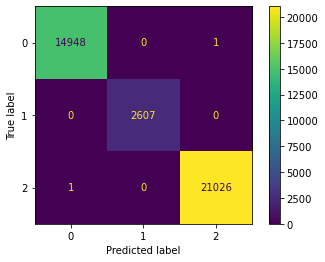

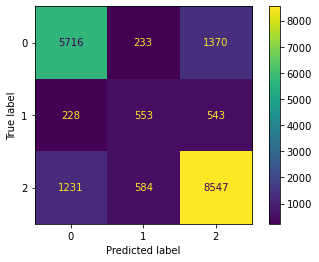

In [159]:
y_hat_train = pipe_rf.predict(X_train)
y_hat_test = pipe_rf.predict(X_test)

print('Evaluation Metrics: Train Data\n')
print(classification_report(y_train,y_hat_train))
print('---------------------------------------------\n')
print('Evaluation Metrics: Test Data\n')
print(classification_report(y_test,y_hat_test))

plot_confusion_matrix(pipe_rf,X_train,y_train)
plot_confusion_matrix(pipe_rf,X_test,y_test)

# XGBoost

In [ ]:
pipe_rf = ImbPipe([('trsfm',clmntr),
                    ('sm',SMOTE(random_state=42)),
                    ('rf',RandomForestClassifier())])
pipe_rf.fit(X_train,y_train)

# Optimizing Best Vanilla Model

In [164]:
param_grid = {
#     'rf__n_estimators': [100,200,300],
#     'rf__criterion': ['gini','entropy'],
#     'rf__max_depth': [10,50,100],
#     'rf__min_samples_split': [50, 200, 300],
#     'rf__min_samples_leaf': [10, 50, 100],
    'rf__max_features':['auto', 'sqrt', 'log2'],
    'sm__sampling_strategy': ['auto','minority','all']
}

search = GridSearchCV(pipe_rf, param_grid, n_jobs=-1,scoring='precision_macro')
search.fit(X_train, y_train)

print("Best parameter (CV score=%0.3f):" % search.best_score_)
print(search.best_params_)

Best parameter (CV score=0.671):
{'rf__max_features': 'auto', 'sm__sampling_strategy': 'minority'}


In [165]:
pipe_rf = ImbPipe([('trsfm',clmntr),
                    ('sm', SMOTE(random_state = 42,sampling_strategy='minority')),
                    ('rf',RandomForestClassifier(max_features = 'auto'))])
pipe_rf.fit(X_train,y_train)

Pipeline(steps=[('trsfm',
                 ColumnTransformer(transformers=[('ohe',
                                                  OneHotEncoder(handle_unknown='ignore',
                                                                sparse=False),
                                                  ['funder', 'installer',
                                                   'basin', 'subvillage',
                                                   'region', 'lga', 'ward',
                                                   'recorded_by',
                                                   'scheme_management',
                                                   'extraction_type',
                                                   'extraction_type_group',
                                                   'extraction_type_class',
                                                   'management',
                                                   'management_group',
                             

Evaluation Metrics: Train Data

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     14949
           1       1.00      1.00      1.00      2607
           2       1.00      1.00      1.00     21027

    accuracy                           1.00     38583
   macro avg       1.00      1.00      1.00     38583
weighted avg       1.00      1.00      1.00     38583

---------------------------------------------

Evaluation Metrics: Test Data

              precision    recall  f1-score   support

           0       0.80      0.78      0.79      7319
           1       0.40      0.42      0.41      1324
           2       0.82      0.82      0.82     10362

    accuracy                           0.78     19005
   macro avg       0.67      0.67      0.67     19005
weighted avg       0.78      0.78      0.78     19005



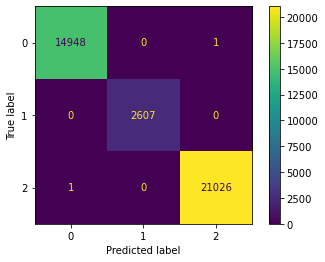

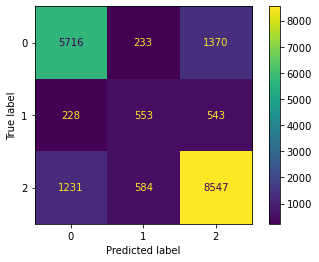

In [162]:
y_hat_train = pipe_rf.predict(X_train)
y_hat_test = pipe_rf.predict(X_test)

print('Evaluation Metrics: Train Data\n')
print(classification_report(y_train,y_hat_train))
print('---------------------------------------------\n')
print('Evaluation Metrics: Test Data\n')
print(classification_report(y_test,y_hat_test))

plot_confusion_matrix(pipe_rf,X_train,y_train)
plot_confusion_matrix(pipe_rf,X_test,y_test)

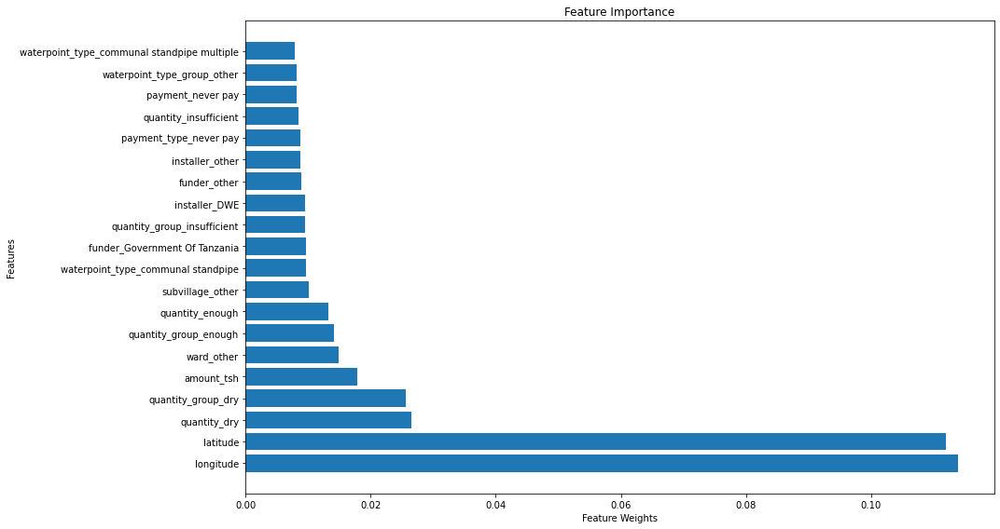

In [163]:
feature_names = list(pipe_rf.named_steps['trsfm'].transformers_[0][1].get_feature_names(X_train.select_dtypes('object').columns))#
feature_names = feature_names + pipe_rf.named_steps['trsfm'].transformers_[1][2]
feature_dict = dict(zip(feature_names,pipe_rf.steps[2][1].feature_importances_))

feature_dict_sorted = {k: v for k, v in sorted(feature_dict.items(), key=lambda item: item[1], reverse = True)}

names = list(feature_dict_sorted.keys())[:20]
vals = list(feature_dict_sorted.values())[:20]

fig, ax = plt.subplots(figsize = (15,8))
plt.barh(names, vals)
plt.title('Feature Importance')
ax.set_xlabel('Feature Weights')
ax.set_ylabel('Features')
plt.tight_layout()
fig.savefig('../images/feature_importance.png');

19.6 ns ± 1.77 ns per loop (mean ± std. dev. of 7 runs, 10000000 loops each)


# Conclusions

**1. Best to sell homes from the northern side of King County, and waterfront homes.** Our analysis shows that as you move north in King County, homes tend to sell for a higher price. The prices also increase as you get closer to the big cities and closer to the waterfront.

**2. Recommend clients to renovate to increase property value.** Our analysis shows that renovated homes sell for a higher price than those homes not renovated. Our models show that renovating to increase square footage increases the sale price and consider adding extra bathrooms in the renovation as that also increases the price. Also consider improving the view of the home when renovating.

**3. Consider selling in the late spring, early summer.** The most homes wre sold in May for both years of our data. Homes tend to increase in sales during the spring and tend decrease slightly in the winter months.  

# Next Steps

Further analyses could provide even more insight into how you will advise your clients to buy or sell thier home. 

**Better idea of features of a home** Other features that indacate home sale include the color of the home, number of windows, garage indicator, size of garage, pool indicator, size of lawn, full property size, flood indicater, style of the home, among others.

**Better idea of neighborhood and surrounding neighborhoods.** We could gather more qualitative data on surrounding neighborhoods such as neighborhood safety, population demographics, and other idicators that may predict the price of a home. You could get an idea of proximity to schools, grocery stores, the city.

**Better idea of surrounding counties in Washington.** We could gather data from other counties and compare, county to county, how sale prices fluctuate. Other macro indicators of county could be political climate, social programs, broader proxiimity to major highways. 

**Better idea of sale history.** We had a fairly good sample of two years worth of data, but it would be good to gather even more years of sales data in King County further solidify reccomendations. There may be features of the home that are better at predicting sale price now then they were 5 or 10 years ago. 

In [203]:
test_dict = {'a':2,'b':4,'g':9,'d':1}

In [207]:
test_dict_sorted = {k: v for k, v in sorted(test_dict.items(), key=lambda item: item[1],reverse=True)}

In [212]:
names = list(test_dict_sorted.keys())[:2]
vals  = list(test_dict_sorted.values())[:2]

<BarContainer object of 2 artists>

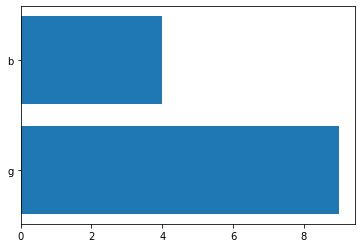

In [213]:
plt.barh(names,vals)